In [1]:
import sys
import os
current_dir = os.getcwd()
print(current_dir)


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all


In [2]:
library_path = os.path.join('..', '..', '..','..','UCB-USACE-LSTMs')
sys.path.insert(0, library_path)
print(sys.path)

['..\\..\\..\\..\\UCB-USACE-LSTMs', 'F:\\Dino\\UCB-USACE-LSTMs\\UCB_training\\models\\warm_springs_all', 'C:\\Users\\Dino\\anaconda3\\python312.zip', 'C:\\Users\\Dino\\anaconda3\\DLLs', 'C:\\Users\\Dino\\anaconda3\\Lib', 'C:\\Users\\Dino\\anaconda3', '', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\win32', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\win32\\lib', 'C:\\Users\\Dino\\anaconda3\\Lib\\site-packages\\Pythonwin']


In [3]:
from pathlib import Path
from neuralhydrology.evaluation.metrics import *
from UCB_training.UCB_train import UCB_trainer
from UCB_training.UCB_utils import combinedPlot
from UCB_training.UCB_utils import fancyCombinedPlot

## Set up Working Directory

In [5]:
# Dynamically find the repo root from the current working directory
current_path = os.getcwd()
library_path = current_path.split('UCB-USACE-LSTMs')[0] + 'UCB-USACE-LSTMs'

# Construct the target path
target_path = os.path.join(library_path, 'UCB_training', 'models', 'warm_springs_all')

# Verify if the directory exists before changing
if os.path.exists(target_path):
    os.chdir(target_path)
    print("Current Working Directory:", os.getcwd())
    print("Train Basin File Exists:", os.path.exists("warm_springs")) #each basin has its own train basin file, so change for different basins e.g "guerneville", etc.
else:
    print(f"Error: The target path '{target_path}' does not exist.")

Current Working Directory: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all
Train Basin File Exists: False


In [6]:
path_to_csv = Path(library_path +'/russian_river_data')
path_to_yaml = Path("warm_springs_dam.yaml") #update the yaml file for different basins

## Standard hourly LSTM (no ensembles, no physics), train on training subset, evaluated on validation period

In [8]:
params = {
    "epochs":8,
    "hidden_size": 128,
    "output_dropout": 0.4,
    "seq_length": 90,
}
lstmNoPhysicsHourly = UCB_trainer(path_to_csv, yaml_path= path_to_yaml, hyperparams= params, hourly=True)

In [9]:
lstmNoPhysicsHourly.train()

2025-02-12 11:34:05,516: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_113405\output.log initialized.
2025-02-12 11:34:05,517: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_113405
2025-02-12 11:34:05,518: ### Run configurations for testing_run
2025-02-12 11:34:05,518: experiment_name: testing_run
2025-02-12 11:34:05,518: train_basin_file: warm springs
2025-02-12 11:34:05,518: validation_basin_file: warm springs
2025-02-12 11:34:05,518: test_basin_file: warm springs
2025-02-12 11:34:05,518: train_start_date: 1994-10-01 00:00:00
2025-02-12 11:34:05,518: train_end_date: 2002-09-30 00:00:00
2025-02-12 11:34:05,518: validation_start_date: 2002-10-01 00:00:00
2025-02-12 11:34:05,518: validation_end_date: 2005-09-30 00:00:00
2025-02-12 11:34:05,518: test_start_date: 2005-10-01 00:00:00
2025-02-12 11:34:05,518: test_end_date: 2009-09-30 00:00:00
2025-02-12 11:34:05,518: device: 

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.83s/it]
2025-02-12 11:38:00,692: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_113405\validation\model_epoch008\validation_metrics.csv
2025-02-12 11:38:00,702: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_113405\validation\model_epoch008\validation_results.p


WindowsPath('F:/Dino/UCB-USACE-LSTMs/UCB_training/models/warm_springs_all/runs/testing_run_1202_113405')

got predictions


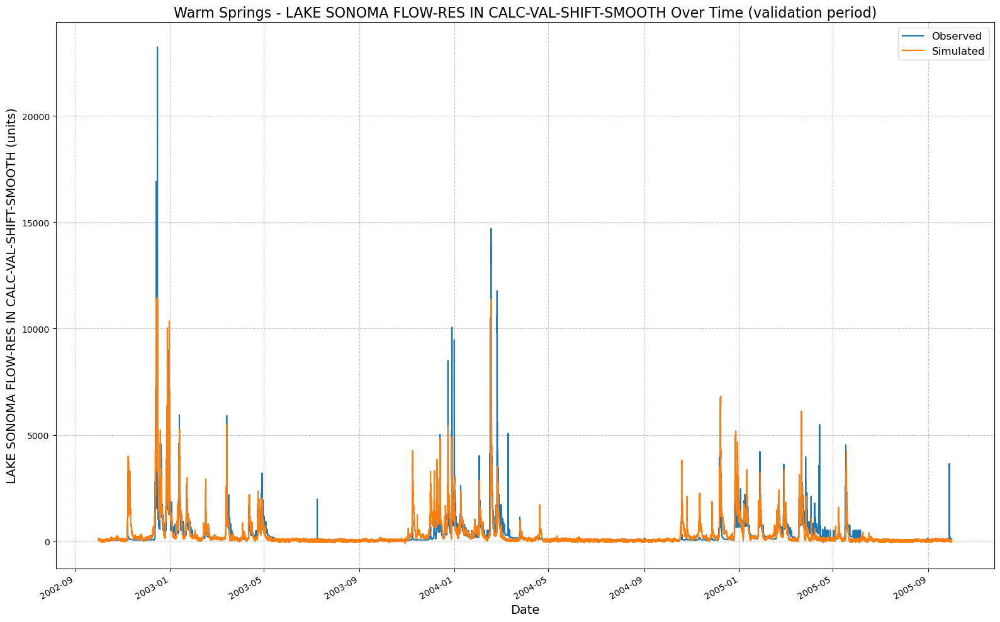

[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_113405\results_output_validation.csv


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


In [10]:
#outputs simple graph, also logs where the csv where the results are stored (use this csv for when you plot combined graph), also prints the metrics
lstmNoPhysicsHourly_results_path_csv, lstmNoPhysicsHourly_results_metrics = lstmNoPhysicsHourly.results() 

## Physics-Informed LSTM (PLSTM) trained on training set, validated on validation set


In [12]:
path_to_physics_data = Path(library_path +"/russian_river_data/WarmSprings_Inflow_hourly.csv")
params = {
    "epochs":8,
    "hidden_size": 128,
    "output_dropout": 0.4,
    "seq_length": 90,
}
features_with_physics = [
    #from hourly.csv
    "DRY CREEK 20 PRECIP-INC SCREENED",
    "DRY CREEK 20 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "DRY CREEK 30 PRECIP-INC SCREENED",
    "DRY CREEK 30 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "UKIAH CA HUMIDITY USAF-NOAA",
    "UKIAH CA SOLAR RADIATION USAF-NOAA",
    "UKIAH CA TEMPERATURE USAF-NOAA",
    "UKIAH CA WINDSPEED USAF-NOAA",
    "SANTA ROSA CA HUMIDITY USAF-NOAA",
    "SANTA ROSA CA SOLAR RADIATION USAF-NOAA",
    "SANTA ROSA CA TEMPERATURE USAF-NOAA",
    "SANTA ROSA CA WINDSPEED USAF-NOAA",
    #from Warm_Spring_Inflow.csv
    'Dry Creek 20 ET-POTENTIAL', 
    'Dry Creek 20 FLOW',
    'Dry Creek 20 FLOW-BASE', 
    'Dry Creek 20 INFILTRATION',
    'Dry Creek 20 PERC-SOIL',
    'Dry Creek 20 SATURATION FRACTION',
    'Dry Creek 30 ET-POTENTIAL', 
    'Dry Creek 30 FLOW',
    'Dry Creek 30 FLOW-BASE', 
    'Dry Creek 30 INFILTRATION',
    'Dry Creek 30 PERC-SOIL',
    'Dry Creek 30 SATURATION FRACTION',
    'Warm Springs Dam Inflow FLOW',
    ]
lstmPhysicsHourly = UCB_trainer(path_to_csv, yaml_path= path_to_yaml, hyperparams= params, input_features= features_with_physics, physics_informed=True, physics_data_file=path_to_physics_data, hourly=True)

In [13]:
lstmPhysicsHourly.train()

2025-02-12 11:38:01,739: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_113801\output.log initialized.
2025-02-12 11:38:01,739: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_113801
2025-02-12 11:38:01,739: ### Run configurations for testing_run
2025-02-12 11:38:01,739: experiment_name: testing_run
2025-02-12 11:38:01,739: train_basin_file: warm springs
2025-02-12 11:38:01,755: validation_basin_file: warm springs
2025-02-12 11:38:01,755: test_basin_file: warm springs
2025-02-12 11:38:01,755: train_start_date: 1994-10-01 00:00:00
2025-02-12 11:38:01,755: train_end_date: 2002-09-30 00:00:00
2025-02-12 11:38:01,755: validation_start_date: 2002-10-01 00:00:00
2025-02-12 11:38:01,763: validation_end_date: 2005-09-30 00:00:00
2025-02-12 11:38:01,763: test_start_date: 2005-10-01 00:00:00
2025-02-12 11:38:01,763: test_end_date: 2009-09-30 00:00:00
2025-02-12 11:38:01,763: device: 

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.73s/it]
2025-02-12 11:42:11,268: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_113801\validation\model_epoch008\validation_metrics.csv
2025-02-12 11:42:11,279: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_113801\validation\model_epoch008\validation_results.p


WindowsPath('F:/Dino/UCB-USACE-LSTMs/UCB_training/models/warm_springs_all/runs/testing_run_1202_113801')

got predictions


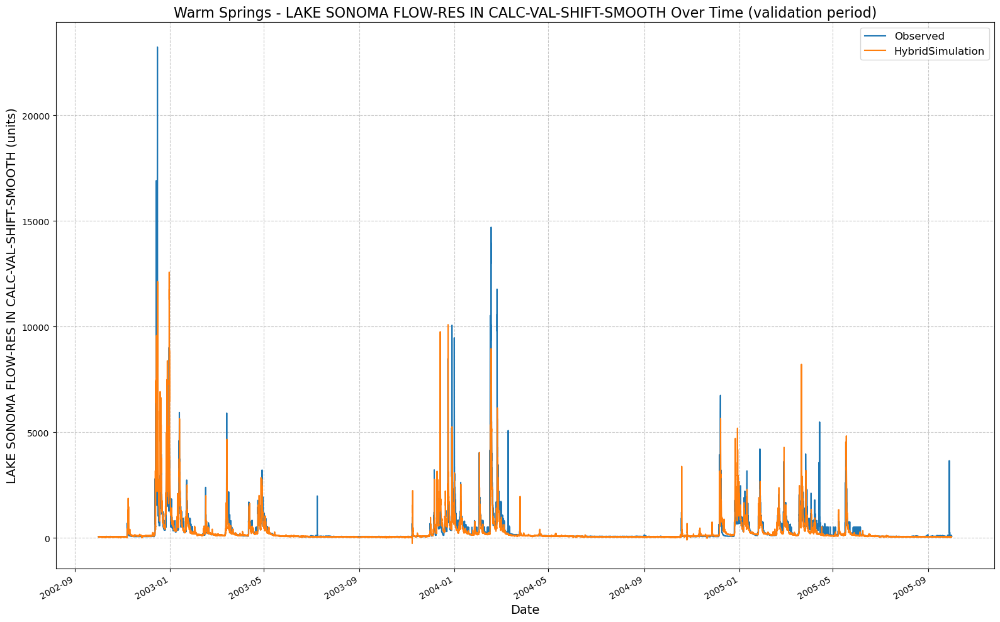

[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_113801\results_output_validation.csv


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)


In [14]:
lstmPhysicsHourly_results_path_csv, lstmPhysicsHourly_results_metrics = lstmPhysicsHourly.results()

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:45: DtypeWarning: Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.
  hms_df = pd.read_csv(HMS_results) #columns: Date, HMS_predicted
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.p

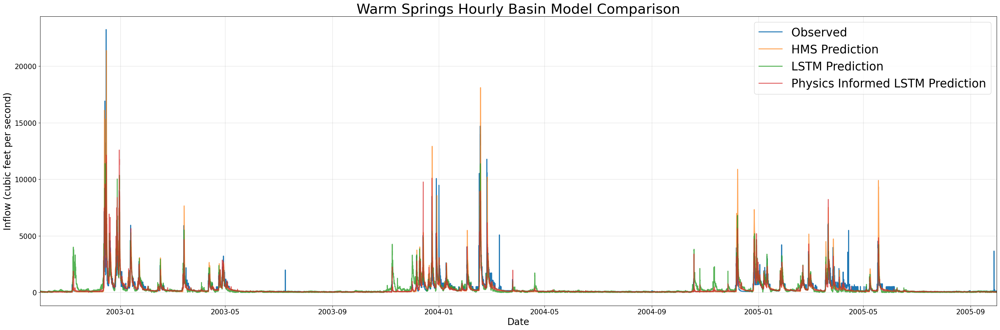

In [15]:
lstm_results_path = lstmNoPhysicsHourly_results_path_csv
lstmPhysics_results_path = lstmPhysicsHourly_results_path_csv
myplot, metrics_df = combinedPlot(lstm_results=lstm_results_path, lstmPhysics_results= lstmPhysics_results_path, HMS_results=path_to_physics_data, title='Warm Springs Hourly Basin Model Comparison', fName = "warm_springs_hourly_eval_metrics.csv")

In [16]:
metrics_df

,HMS,LSTM,Physics_Informed_LSTM
NSE,0.006826,0.568239,0.594574
MSE,630255.178815,273989.768708,257278.172385
RMSE,793.886125,523.440320,507.225958
KGE,0.526288,0.764518,0.748588
Alpha-NSE,1.322813,0.944405,0.906414
Beta-KGE,1.087251,1.029820,0.917255
Beta-NSE,0.035655,0.012186,-0.033814
Pearson-r,0.664467,0.773126,0.781819
FHV,35.450486,-6.181521,-5.399033
FMS,12.396291,21.210025,-1.691303


## If you prefer the interactive plotly graph , you can use 'fancyCombinedPlot' (must have plotly library downloaded)

In [18]:
path_to_physics_data = Path(library_path +"/russian_river_data/WarmSprings_Inflow_hourly.csv")

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:116: DtypeWarning: Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.
  hms_df = pd.read_csv(HMS_results)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  offset_one = to_offset(freq_one)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning: 'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.
  factor = pd.to_timedelta(freq_one) / pd.to_timedelta(freq_two)
F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning: 'H' is 

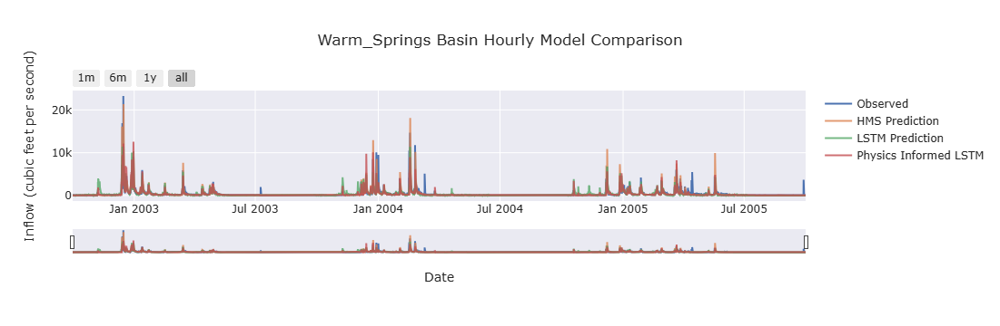

,HMS,LSTM,Physics_Informed_LSTM
NSE,0.006826,0.568239,0.594574
MSE,630255.178815,273989.768708,257278.172385
RMSE,793.886125,523.440320,507.225958
KGE,0.526288,0.764518,0.748588
Alpha-NSE,1.322813,0.944405,0.906414
Beta-KGE,1.087251,1.029820,0.917255
Beta-NSE,0.035655,0.012186,-0.033814
Pearson-r,0.664467,0.773126,0.781819
FHV,35.450486,-6.181521,-5.399033
FMS,12.396291,21.210025,-1.691303


In [19]:
fancyCombinedPlot(lstm_results=lstm_results_path, lstmPhysics_results= lstmPhysics_results_path, HMS_results=path_to_physics_data, title='Warm_Springs Basin Hourly Model Comparison', fName = "warm_springs_hourly_eval_metrics.csv")

## Re-train standard hourly LSTM (no ensembles, no physics) on entire dataset, evaluate on test period

In [21]:
params = {
    "epochs":16,
    "hidden_size": 128,
    "output_dropout": 0.4,
    "seq_length": 90,
}
lstmNoPhysicsHourlyExt = UCB_trainer(path_to_csv, yaml_path= path_to_yaml, hyperparams= params, hourly=True, extend_train_period=True)

In [22]:
lstmNoPhysicsHourlyExt.train()

2025-02-12 11:42:20,398: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_114220\output.log initialized.
2025-02-12 11:42:20,398: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_114220
2025-02-12 11:42:20,398: ### Run configurations for testing_run
2025-02-12 11:42:20,398: experiment_name: testing_run
2025-02-12 11:42:20,398: train_basin_file: warm springs
2025-02-12 11:42:20,414: validation_basin_file: warm springs
2025-02-12 11:42:20,414: test_basin_file: warm springs
2025-02-12 11:42:20,414: train_start_date: 1994-10-01 00:00:00
2025-02-12 11:42:20,414: train_end_date: 2005-09-30 00:00:00
2025-02-12 11:42:20,414: validation_start_date: 2002-10-01 00:00:00
2025-02-12 11:42:20,414: validation_end_date: 2005-09-30 00:00:00
2025-02-12 11:42:20,414: test_start_date: 2005-10-01 00:00:00
2025-02-12 11:42:20,414: test_end_date: 2009-09-30 00:00:00
2025-02-12 11:42:20,414: device: 

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental featur

# Validation: 100%|██████████| 1/1 [00:05<00:00,  5.68s/it]
2025-02-12 11:52:51,930: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_114220\validation\model_epoch016\validation_metrics.csv
2025-02-12 11:52:51,932: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_114220\validation\model_epoch016\validation_results.p


WindowsPath('F:/Dino/UCB-USACE-LSTMs/UCB_training/models/warm_springs_all/runs/testing_run_1202_114220')

2025-02-12 11:52:52,013: Using the model weights from F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_114220\model_epoch016.pt


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental featur

# Evaluation: 100%|██████████| 1/1 [00:06<00:00,  6.74s/it]
2025-02-12 11:52:58,773: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_114220\test\model_epoch016\test_metrics.csv
2025-02-12 11:52:58,783: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_114220\test\model_epoch016\test_results.p
got predictions


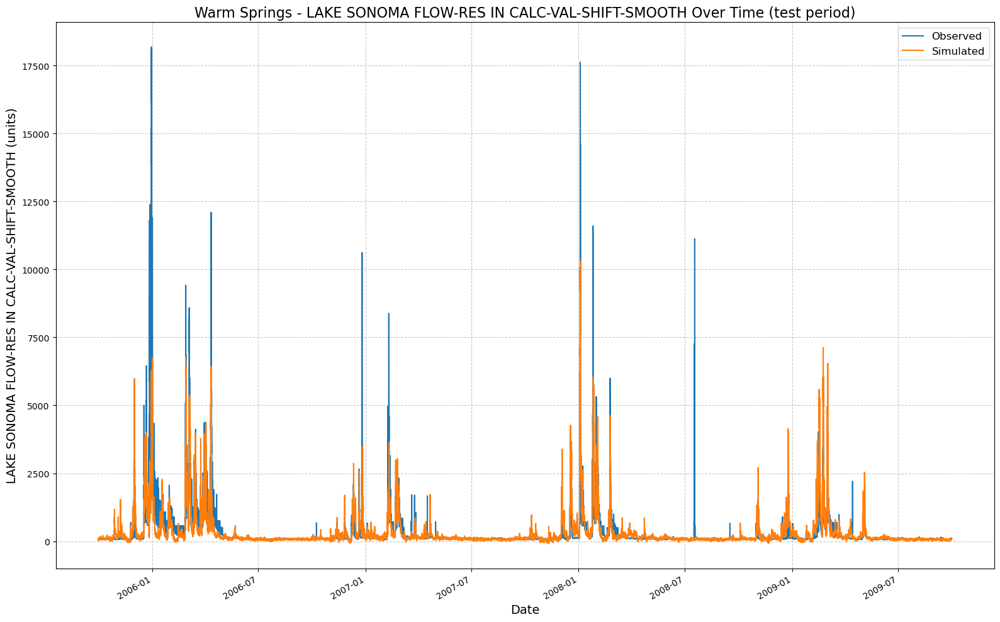

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.



[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_114220\results_output_test.csv


In [23]:
lstmNoPhysicsHourlyExt_results_path_csv, lstmNoPhysicsHourlyExt_results_metrics = lstmNoPhysicsHourlyExt.results('test')

## Re-train physics hourly LSTM (no ensembles, no physics) on entire dataset, evaluate on test period

In [25]:
path_to_physics_data = Path(library_path +"/russian_river_data/WarmSprings_Inflow_hourly.csv")
params = {
    "epochs":16,
    "hidden_size": 128,
    "output_dropout": 0.4,
    "seq_length": 90,
}
features_with_physics = [
    #from hourly.csv
    "DRY CREEK 20 PRECIP-INC SCREENED",
    "DRY CREEK 20 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "DRY CREEK 30 PRECIP-INC SCREENED",
    "DRY CREEK 30 ET-POTENTIAL RUN:BASIN AVERAGE 60 YR",
    "UKIAH CA HUMIDITY USAF-NOAA",
    "UKIAH CA SOLAR RADIATION USAF-NOAA",
    "UKIAH CA TEMPERATURE USAF-NOAA",
    "UKIAH CA WINDSPEED USAF-NOAA",
    "SANTA ROSA CA HUMIDITY USAF-NOAA",
    "SANTA ROSA CA SOLAR RADIATION USAF-NOAA",
    "SANTA ROSA CA TEMPERATURE USAF-NOAA",
    "SANTA ROSA CA WINDSPEED USAF-NOAA",
    #from Warm_Spring_Inflow.csv
    'Dry Creek 20 ET-POTENTIAL', 
    'Dry Creek 20 FLOW',
    'Dry Creek 20 FLOW-BASE', 
    'Dry Creek 20 INFILTRATION',
    'Dry Creek 20 PERC-SOIL',
    'Dry Creek 20 SATURATION FRACTION',
    'Dry Creek 30 ET-POTENTIAL', 
    'Dry Creek 30 FLOW',
    'Dry Creek 30 FLOW-BASE', 
    'Dry Creek 30 INFILTRATION',
    'Dry Creek 30 PERC-SOIL',
    'Dry Creek 30 SATURATION FRACTION',
    'Warm Springs Dam Inflow FLOW',
    ]
lstmPhysicsHourlyExt = UCB_trainer(path_to_csv, yaml_path= path_to_yaml, hyperparams= params, input_features= features_with_physics, physics_informed=True, physics_data_file=path_to_physics_data, hourly=True, extend_train_period=True)

In [26]:
lstmPhysicsHourlyExt.train()

2025-02-12 11:52:59,912: Logging to F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_115259\output.log initialized.
2025-02-12 11:52:59,912: ### Folder structure created at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_115259
2025-02-12 11:52:59,912: ### Run configurations for testing_run
2025-02-12 11:52:59,912: experiment_name: testing_run
2025-02-12 11:52:59,912: train_basin_file: warm springs
2025-02-12 11:52:59,912: validation_basin_file: warm springs
2025-02-12 11:52:59,912: test_basin_file: warm springs
2025-02-12 11:52:59,920: train_start_date: 1994-10-01 00:00:00
2025-02-12 11:52:59,920: train_end_date: 2005-09-30 00:00:00
2025-02-12 11:52:59,920: validation_start_date: 2002-10-01 00:00:00
2025-02-12 11:52:59,920: validation_end_date: 2005-09-30 00:00:00
2025-02-12 11:52:59,920: test_start_date: 2005-10-01 00:00:00
2025-02-12 11:52:59,920: test_end_date: 2009-09-30 00:00:00
2025-02-12 11:52:59,920: device: 

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental featur

# Validation: 100%|██████████| 1/1 [00:07<00:00,  7.50s/it]
2025-02-12 12:04:23,690: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_115259\validation\model_epoch016\validation_metrics.csv
2025-02-12 12:04:23,697: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_115259\validation\model_epoch016\validation_results.p


WindowsPath('F:/Dino/UCB-USACE-LSTMs/UCB_training/models/warm_springs_all/runs/testing_run_1202_115259')

2025-02-12 12:04:23,816: Using the model weights from F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_115259\model_epoch016.pt


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\evaluation\tester.py:133: FutureWarning:

You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental featur

# Evaluation: 100%|██████████| 1/1 [00:08<00:00,  8.72s/it]
2025-02-12 12:04:32,560: Stored metrics at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_115259\test\model_epoch016\test_metrics.csv
2025-02-12 12:04:32,571: Stored results at F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_115259\test\model_epoch016\test_results.p
got predictions


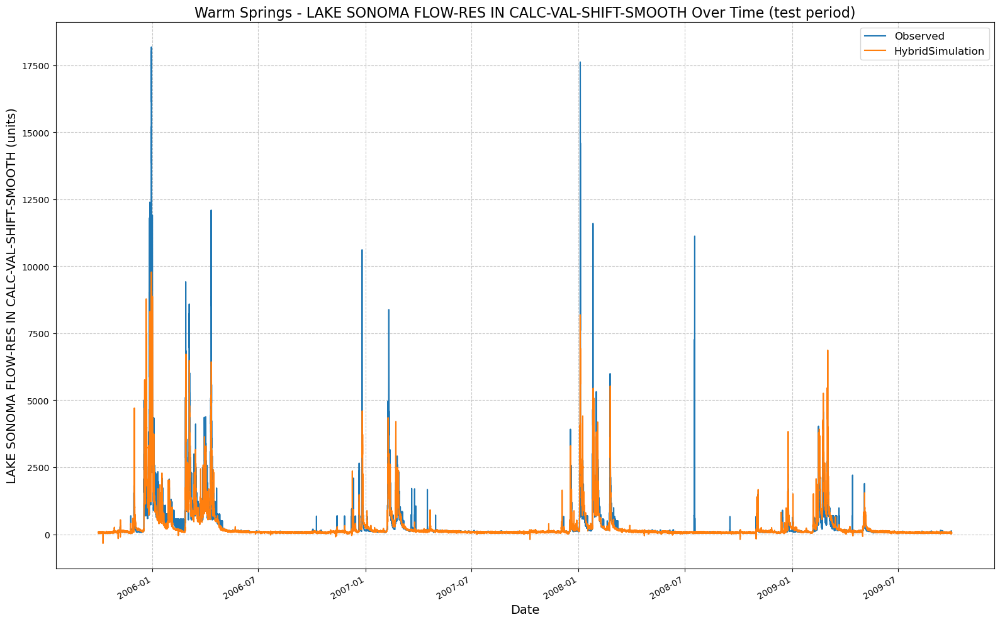

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.



[INFO] CSV output saved at: F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\runs\testing_run_1202_115259\results_output_test.csv


In [27]:
lstmPhysicsHourlyExt_results_path_csv, lstmPhysicsHourlyExt_results_metrics = lstmPhysicsHourlyExt.results('test')

## compare results

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:45: DtypeWarning:

Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_spri

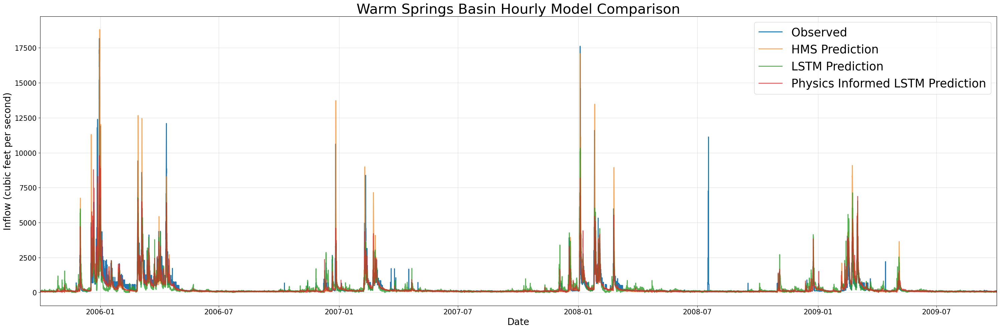

In [29]:
lstm_results_path_ext = lstmNoPhysicsHourlyExt_results_path_csv
lstmPhysics_results_path_ext = lstmPhysicsHourlyExt_results_path_csv
myplot, metrics_df = combinedPlot(lstm_results=lstm_results_path_ext, lstmPhysics_results= lstmPhysics_results_path_ext, HMS_results=path_to_physics_data, title='Warm Springs Basin Hourly Model Comparison', fName = "warm_springs_hourly_metrics.csv")

In [30]:
metrics_df

,HMS,LSTM,Physics_Informed_LSTM
NSE,0.330367,0.495360,0.684639
MSE,450006.212466,339127.715144,211928.772382
RMSE,670.825024,582.346731,460.357223
KGE,0.672432,0.605081,0.708287
Alpha-NSE,1.183743,0.738147,0.773001
Beta-KGE,1.038003,0.987752,0.932338
Beta-NSE,0.013794,-0.004446,-0.024559
Pearson-r,0.731495,0.704630,0.829735
FHV,25.384240,-21.810230,-16.529505
FMS,30.893206,30.176048,13.991023


F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\UCB_training\UCB_utils.py:116: DtypeWarning:

Columns (0,3,4,5,6,7,8,9,10,11,12,13,14,15) have mixed types. Specify dtype option on import or set low_memory=False.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:382: FutureWarning:

'H' is deprecated and will be removed in a future version. Please use 'h' instead of 'H'.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_springs_all\..\..\..\..\UCB-USACE-LSTMs\neuralhydrology\datautils\utils.py:339: FutureWarning:

'H' is deprecated and will be removed in a future version, please use 'h' instead.

F:\Dino\UCB-USACE-LSTMs\UCB_training\models\warm_spr

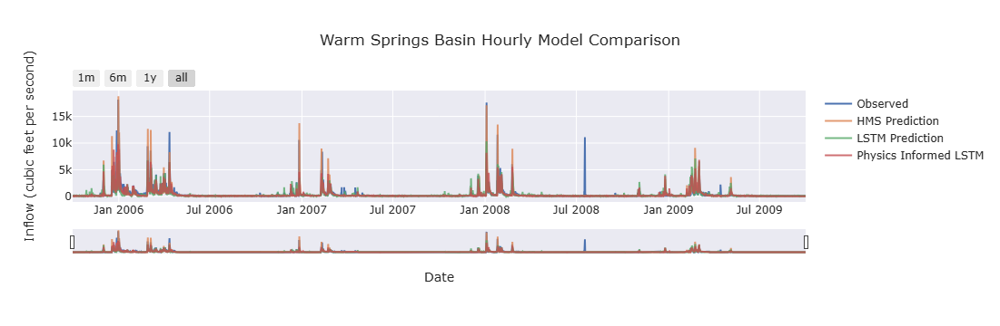

,HMS,LSTM,Physics_Informed_LSTM
NSE,0.330367,0.495360,0.684639
MSE,450006.212466,339127.715144,211928.772382
RMSE,670.825024,582.346731,460.357223
KGE,0.672432,0.605081,0.708287
Alpha-NSE,1.183743,0.738147,0.773001
Beta-KGE,1.038003,0.987752,0.932338
Beta-NSE,0.013794,-0.004446,-0.024559
Pearson-r,0.731495,0.704630,0.829735
FHV,25.384240,-21.810230,-16.529505
FMS,30.893206,30.176048,13.991023


In [31]:
fancyCombinedPlot(lstm_results=lstm_results_path_ext, lstmPhysics_results= lstmPhysics_results_path_ext, HMS_results=path_to_physics_data, title='Warm Springs Basin Hourly Model Comparison', fName = "warm_springs_hourly_metrics.csv")